In [ ]:
!pip install -qU pycocotools transformers albumentations torchmetrics supervision

In [ ]:
!unzip xray-detection.v16i.coco.zip -d data/

Archive:  xray-detection.v16i.coco.zip
  inflating: data/README.dataset.txt  
  inflating: data/README.roboflow.txt  
   creating: data/test/
 extracting: data/test/468_png.rf.27eda7e5bc9f38dbe07f0ec1ef94b741.jpg  
 extracting: data/test/474_png.rf.9c839943604a4413b1e31b9271aa86fc.jpg  
 extracting: data/test/476_png.rf.01a81a9a3015c22e9ee14e5c8b6c9b85.jpg  
 extracting: data/test/493_png.rf.c05c9560d829652b8a8b26570fc4c7f1.jpg  
 extracting: data/test/498_png.rf.721fb95a7fc72b0abd479f097a10081c.jpg  
 extracting: data/test/49_png.rf.22c7e86614e0ab6294017f1fafe81e24.jpg  
 extracting: data/test/504_png.rf.4cd6d2317285c83ca848b89f8d55f79e.jpg  
 extracting: data/test/50_png.rf.5f783190f9a1afce04051aec1b2c1a17.jpg  
 extracting: data/test/510_png.rf.fafd84d4a8df43199deeb78aefd0b016.jpg  
 extracting: data/test/516_png.rf.68edf90c33455facab6b1907e4dbe7bb.jpg  
 extracting: data/test/517_png.rf.b606ec1c5bae8f0e0fe9c5e7d19901b3.jpg  
 extracting: data/test/519_png.rf.0ba0f2376e004ebd6349a50

In [ ]:
import torch
from PIL import Image
import requests

id2label = {
    0: "periodontitis-impaction-caries",
    1: "caries",
    2: "impaction",
    3: "periodontitis",
}

label2id = {v: k for k, v in id2label.items()}

In [ ]:
!unrar x detr_xray.rar


UNRAR 6.11 beta 1 freeware      Copyright (c) 1993-2022 Alexander Roshal


Extracting from detr_xray.rar

Creating    detr_xray                                                 OK
Extracting  detr_xray/config.json                                          0%  OK 
Extracting  detr_xray/model.safetensors                                    2%  5%  8% 10% 13% 16% 18% 21% 24% 27% 29% 32% 35% 37% 40% 43% 45% 48% 51% 54% 56% 59% 62% 64% 67% 70% 73% 75% 78% 81% 83% 86% 89% 91% 94% 97% 99%  OK 
Extracting  detr_xray/preprocessor_config.json                            99%  OK 
Extracting  detr_xray/training_args.bin                                   99%  OK 
All OK


In [ ]:
from transformers import DetrForObjectDetection, DetrImageProcessor
import torch

model = DetrForObjectDetection.from_pretrained(
    "/content/detr_xray",
    id2label=id2label,
    label2id=label2id,
    ignore_mismatched_sizes=True,
)
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/290 [00:00<?, ?B/s]

DetrForObjectDetection(
  (model): DetrModel(
    (backbone): DetrConvModel(
      (conv_encoder): DetrConvEncoder(
        (model): FeatureListNet(
          (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (bn1): DetrFrozenBatchNorm2d()
          (act1): ReLU(inplace=True)
          (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
          (layer1): Sequential(
            (0): Bottleneck(
              (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (bn1): DetrFrozenBatchNorm2d()
              (act1): ReLU(inplace=True)
              (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (bn2): DetrFrozenBatchNorm2d()
              (drop_block): Identity()
              (act2): ReLU(inplace=True)
              (aa): Identity()
              (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      

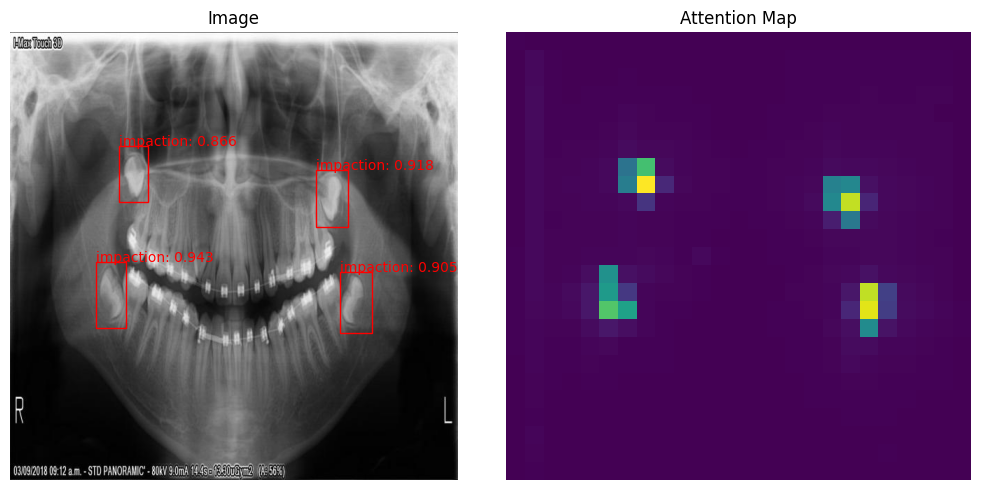

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import torch

image = Image.open("/content/468_png.rf.27eda7e5bc9f38dbe07f0ec1ef94b741.jpg").convert("RGB")

inputs = processor(images=image, return_tensors="pt").to(device)
outputs = model(**inputs, output_attentions=True)

target_sizes = torch.tensor([image.size[::-1]])
results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

probas = outputs.logits.softmax(-1)[0, :, :-1]
keep = probas.max(-1).values > 0.5

if len(keep.nonzero()) == 1:
    indices = keep.nonzero().squeeze(0)
else:
    indices = keep.nonzero().squeeze()

num_queries = len(indices)

fig, ax = plt.subplots(1, 2, figsize = (10, 5))

all_head_attentions = outputs.cross_attentions[-1][0]  # (8, 100, 625)

mean_attention = torch.mean(all_head_attentions, dim=0)
mean_indices_attention = mean_attention[indices,:]
attention_mean = torch.mean(mean_indices_attention, dim=0)


ax[0].imshow(image)
ax[0].axis("off")
ax[0].set_title("Image")

for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    xmin, ymin, xmax, ymax = box.tolist()

    rect = patches.Rectangle((xmin, ymin), (xmax - xmin), (ymax - ymin), linewidth=1, edgecolor="r", facecolor="none")

    ax[0].add_patch(rect)

    ax[0].text(xmin, ymin, f"{model.config.id2label[label.item()]}: {score.item():.3f}", color="r")

h, w = inputs['pixel_values'].shape[-2:]
attention_map_resized = attention_mean.reshape(25 , 25).detach().cpu().numpy() # Assuming feature map is 32x smaller
# Görselleştirme
sns.heatmap(attention_map_resized, cmap='viridis', cbar=False , ax=ax[1])
ax[1].set_title(f"Attention Map")
ax[1].axis("off")

plt.tight_layout()
plt.show()

In [ ]:
!pip install -qU gradio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 MB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 320.4/320.4 kB 17.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.8/94.8 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.2/11.2 MB 96.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.2/73.2 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.3/62.3 kB 3.7 MB/s eta 0:00:00


In [ ]:
import gradio as gr
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import torch
import cv2
import numpy as np

def predict(image, threshold=0.5):
  inputs = processor(images=image, return_tensors="pt").to(device)
  outputs = model(**inputs, output_attentions=True)

  target_sizes = torch.tensor([image.size[::-1]])
  results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

  probas = outputs.logits.softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  colors = {
    "periodontitis-impaction-caries": (255, 0, 0),  # Kırmızı
    "caries": (0, 255, 0),  # Yeşil
    "impaction": (0, 0, 255),  # Mavi
    "periodontitis": (255, 255, 0),  # Sarı
  }

  image_bbox = np.array(image.copy())
  for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
      xmin, ymin, xmax, ymax = box.tolist()
      label_name = model.config.id2label[label.item()]
      color = colors[label_name]
      cv2.rectangle(image_bbox, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, 1)  # (0, 255, 0) yeşil renk, 2 kalınlık
      text = f"{label_name}: {score.item():.3f}"
      cv2.putText(image_bbox, text, (int(xmin), int(ymin - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

  image_bbox = Image.fromarray(image_bbox)
  if len(keep.nonzero()) == 1:
      indices = keep.nonzero().squeeze(0)
  else:
      indices = keep.nonzero().squeeze()

  num_queries = len(indices)

  all_head_attentions = outputs.cross_attentions[-1][0]  # (8, 100, 625)
  mean_attention = torch.mean(all_head_attentions, dim=0)
  mean_indices_attention = mean_attention[indices,:]
  attention_mean = torch.mean(mean_indices_attention, dim=0)

  h, w = inputs['pixel_values'].shape[-2:]
  attention_map_resized = attention_mean.reshape(25 , 25).detach().cpu().numpy() # Assuming feature map is 32x smaller

  heatmap_resized = cv2.resize(attention_map_resized, (image.width, image.height))
  heatmap_normalized = (heatmap_resized - np.min(heatmap_resized)) / (np.max(heatmap_resized) - np.min(heatmap_resized))
  heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_normalized), cv2.COLORMAP_TURBO)
  heatmap_colored_rgb = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
  overlayed_image = cv2.addWeighted(heatmap_colored_rgb, 0.5, np.array(image), 0.5, 0)

  return image_bbox, overlayed_image

iface = gr.Interface(
    fn=predict,
    inputs=[
        gr.Image(type="pil"),
        gr.Slider(minimum=0,maximum=1, step=0.01,value=0.5, label="Threshold")
    ],
    outputs=[
        gr.Image(type="pil"),
        gr.Image(type="pil")
    ],
    title="Nesne Tespiti ve Isı Haritası",
)

iface.launch()

Running Gradio in a Colab notebook requires sharing enabled. Automatically setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://8ce8093a52465b1b82.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


In [ ]:
import gradio as gr
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as patches
import torch
import cv2
import numpy as np

def prediction_test(image, threshold=0.5):
  inputs = processor(images=image, return_tensors="pt").to(device)
  outputs = model(**inputs, output_attentions=True)

  target_sizes = torch.tensor([image.size[::-1]])
  results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

  probas = outputs.logits.softmax(-1)[0, :, :-1]
  keep = probas.max(-1).values > threshold

  colors = {
    "periodontitis-impaction-caries": (255, 0, 0),  # Kırmızı
    "caries": (0, 255, 0),  # Yeşil
    "impaction": (0, 0, 255),  # Mavi
    "periodontitis": (255, 255, 0),  # Sarı
  }

  image_bbox = np.array(image.copy())
  for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
      xmin, ymin, xmax, ymax = box.tolist()
      label_name = model.config.id2label[label.item()]
      color = colors[label_name]
      cv2.rectangle(image_bbox, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, 1)  # (0, 255, 0) yeşil renk, 2 kalınlık
      text = f"{label_name}: {score.item():.3f}"
      cv2.putText(image_bbox, text, (int(xmin), int(ymin - 10)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

  image_bbox = Image.fromarray(image_bbox)

  if len(keep.nonzero()) == 1:
      indices = keep.nonzero().squeeze(0)
  else:
      indices = keep.nonzero().squeeze()

  num_queries = len(indices)

  all_head_attentions = outputs.cross_attentions[-1][0]  # (8, 100, 625)
  mean_attention = torch.mean(all_head_attentions, dim=0)
  mean_indices_attention = mean_attention[indices,:]
  attention_mean= torch.mean(mean_indices_attention, dim=0)

  h, w = inputs['pixel_values'].shape[-2:]
  attention_map_resized = attention_mean.reshape(h // 32 , w // 32).detach().cpu().numpy()

  heatmap_resized = cv2.resize(attention_map_resized, (image.width, image.height))
  heatmap_normalized = (heatmap_resized - np.min(heatmap_resized)) / (np.max(heatmap_resized) - np.min(heatmap_resized))
  heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_normalized), cv2.COLORMAP_TURBO)
  heatmap_colored_rgb = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
  overlayed_image = cv2.addWeighted(heatmap_colored_rgb, 0.5, np.array(image), 0.5, 0)

  return image, image_bbox, overlayed_image

In [ ]:
image1, image2, image3 = prediction_test(image, 0.5)

array([[[ 68,  54,  76],
        [ 70,  56,  78],
        [ 72,  57,  80],
        ...,
        [ 72,  56,  77],
        [ 68,  53,  74],
        [ 65,  50,  70]],

       [[140, 126, 148],
        [147, 132, 156],
        [151, 136, 160],
        ...,
        [148, 134, 154],
        [146, 130, 151],
        [142, 128, 148]],

       [[152, 137, 160],
        [152, 138, 160],
        [152, 138, 161],
        ...,
        [152, 136, 157],
        [149, 134, 154],
        [146, 132, 152]],

       ...,

       [[ 26,  12,  32],
        [ 24,   9,  30],
        [ 24,   9,  30],
        ...,
        [ 40,  24,  45],
        [ 50,  36,  56],
        [ 60,  45,  66]],

       [[ 34,  20,  40],
        [ 31,  16,  36],
        [ 27,  12,  32],
        ...,
        [ 39,  24,  44],
        [ 49,  34,  54],
        [ 58,  44,  64]],

       [[ 40,  24,  45],
        [ 38,  23,  44],
        [ 39,  24,  44],
        ...,
        [ 32,  18,  38],
        [ 39,  24,  44],
        [ 46,  32,  52]]], dtype=uint8)
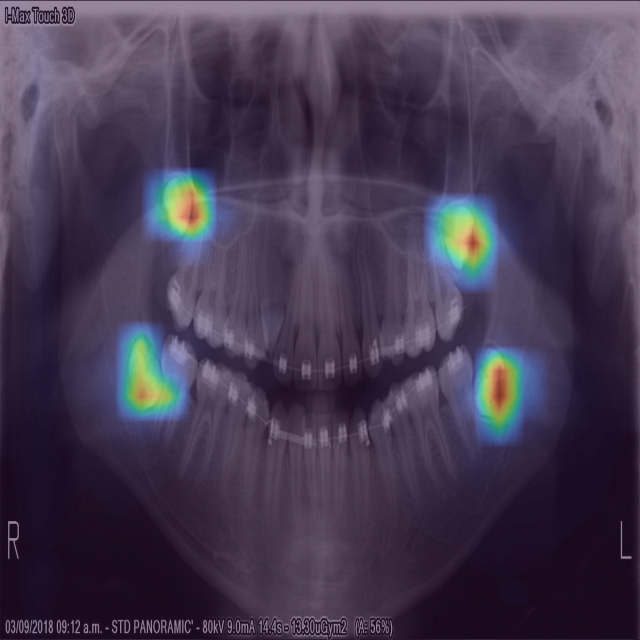

In [ ]:
image3

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


<ipython-input-12-32823edb4260>:58: RuntimeWarning: invalid value encountered in cast
  heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_normalized), cv2.COLORMAP_TURBO)


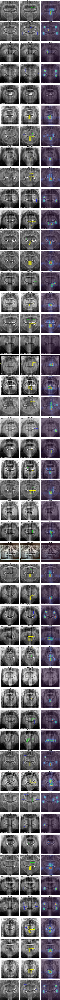

In [ ]:
import os
import matplotlib.pyplot as plt
import cv2
from pycocotools.coco import COCO
from matplotlib.backends.backend_pdf import PdfPages
from PIL import Image

def predict_test_all(annotation_file, test_folder_path, threshold=0.5):
  coco_test = COCO(annotation_file)

  image_filenames = []
  imgIds = coco_test.getImgIds()
  for imgId in imgIds:
      image_filenames.append(coco_test.loadImgs(imgId)[0]['file_name'])

  fig, axes = plt.subplots(len(image_filenames), 3, figsize=(15, 5 * len(image_filenames)))

  for i, image_file in enumerate(image_filenames):
      image_path = os.path.join(test_folder_path, image_file)

      image = Image.open(image_path).convert("RGB")
      image1, image2, image3 = prediction_test(image,threshold)

      axes[i, 0].imshow(image1)
      axes[i, 0].axis("off")
      axes[i, 0].set_title(f"Test Image {i+1}")

      axes[i, 1].imshow(image2)
      axes[i, 1].axis("off")
      axes[i, 1].set_title("Bounding Boxes")

      axes[i, 2].imshow(image3)
      axes[i, 2].axis("off")
      axes[i, 2].set_title("Heatmap")

  plt.tight_layout()
  plt.show()
  fig.savefig("result.pdf")

annotation_file = "/content/data/test/_annotations.coco.json"
test_folder_path = "/content/data/test"
predict_test_all(annotation_file, test_folder_path, 0.5)

In [ ]:
import os
import matplotlib.pyplot as plt
import cv2
from pycocotools.coco import COCO
from matplotlib.backends.backend_pdf import PdfPages
from PIL import Image

def predict_test_all_image(annotation_file, test_folder_path, threshold=0.5):
  coco_test = COCO(annotation_file)
  image_filenames = []
  imgIds = coco_test.getImgIds()

  for imgId in imgIds:
      image_filenames.append(coco_test.loadImgs(imgId)[0]['file_name'])

  os.makedirs('results_image', exist_ok=True)  # Klasör yoksa oluştur

  for i, image_file in enumerate(image_filenames):
      image_path = os.path.join(test_folder_path, image_file)
      image = Image.open(image_path).convert("RGB")
      image1, image2, image3 = prediction_test(image, threshold)

      fig, axes = plt.subplots(1, 3, figsize=(15, 5))

      axes[0].imshow(image1)
      axes[0].axis("off")
      axes[0].set_title(f"Test Image {i+1}")

      axes[1].imshow(image2)
      axes[1].axis("off")
      axes[1].set_title("Bounding Boxes")

      axes[2].imshow(image3)
      axes[2].axis("off")
      axes[2].set_title("Heatmap")

      plt.tight_layout()
      fig.savefig(f'results_image/{i+1}.png')
      plt.close(fig)  # Belleği temizlemek için figürü kapatın

# Test görsellerinin bulunduğu klasör yolunu belirtin
annotation_file = "/content/data/test/_annotations.coco.json"
test_folder_path = "/content/data/test"
# Fonksiyonu çağırın
predict_test_all_image(annotation_file, test_folder_path, 0.5)

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


<ipython-input-12-32823edb4260>:58: RuntimeWarning: invalid value encountered in cast
  heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_normalized), cv2.COLORMAP_TURBO)


In [ ]:
!zip -r results_image.zip results_image

  adding: results_image/ (stored 0%)
  adding: results_image/10.png (deflated 1%)
  adding: results_image/19.png (deflated 1%)
  adding: results_image/15.png (deflated 1%)
  adding: results_image/34.png (deflated 1%)
  adding: results_image/20.png (deflated 1%)
  adding: results_image/5.png (deflated 2%)
  adding: results_image/21.png (deflated 2%)
  adding: results_image/9.png (deflated 1%)
  adding: results_image/16.png (deflated 1%)
  adding: results_image/28.png (deflated 1%)
  adding: results_image/3.png (deflated 2%)
  adding: results_image/37.png (deflated 1%)
  adding: results_image/14.png (deflated 1%)
  adding: results_image/41.png (deflated 1%)
  adding: results_image/30.png (deflated 1%)
  adding: results_image/22.png (deflated 1%)
  adding: results_image/25.png (deflated 2%)
  adding: results_image/31.png (deflated 1%)
  adding: results_image/44.png (deflated 1%)
  adding: results_image/45.png (deflated 1%)
  adding: results_image/26.png (deflated 1%)
  adding: results_ima

In [ ]:
import os
import zipfile
from math import ceil

def zip_images_in_batches(folder_path, output_folder, batch_size=10):
    files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

    image_files = [f for f in files if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]

    os.makedirs(output_folder, exist_ok=True)

    for i in range(ceil(len(image_files) / batch_size)):
        batch = image_files[i * batch_size:(i + 1) * batch_size]
        zip_file_path = os.path.join(output_folder, f'result_{i + 1}.zip')

        with zipfile.ZipFile(zip_file_path, 'w') as zipf:
            for image in batch:
                image_path = os.path.join(folder_path, image)
                zipf.write(image_path, arcname=image)

        print(f"Created: {zip_file_path}")

folder_path = "/content/results_image"
output_folder = "/content/results_zip"
zip_images_in_batches(folder_path, output_folder)


Created: /content/results_zip/batch_1.zip
Created: /content/results_zip/batch_2.zip
Created: /content/results_zip/batch_3.zip
Created: /content/results_zip/batch_4.zip
Created: /content/results_zip/batch_5.zip
